# Allen Institute' Mouse Brain Cell Diversity dataset

~75K cells. ~6GB of data.

Found via alleninstitute.org: [Cell Types Database: RNA-Seq Data](https://portal.brain-map.org/atlases-and-data/rnaseq#Mouse_Cortex_and_Hip)

## Legal

Apache 2.0 licensed by Reconstrue 2019

Started 2019-12-13 by cut and paste from repo's datashader_on_colab.ipynb.

## Set up

In [0]:
# Datashader is all that needs to be installed. Takes a few seconds.
!pip install --quiet datashader

In [0]:
import umap
import numpy as np
import pandas as pd
import requests
import os
import datashader as ds
import datashader.utils as utils
import datashader.transfer_functions as tf
import matplotlib.pyplot as plt
import seaborn as sns
import zipfile
import urllib.request

sns.set(font_scale=2.0, style="white")

#### Data load

Scroll on down to the above page's section, [Cell Diversity in the Mouse Cortex and Hippocampus
RNA-Seq Data Summary](https://portal.brain-map.org/atlases-and-data/rnaseq#Mouse_Cortex_and_Hip). There are 8 files in the Cell Diversity dataset. Two are needed just to scatter plot:
- 2d-coordinates.zip: columns = `sample_name`, `tsne_1`, `tsne_2`
- sample-annotations.zip: `sample_name`

##### 2d-coordinates.zip
They have a pre-learned embedding, [2D coordinates](https://transcriptomic-viewer-downloads.s3-us-west-2.amazonaws.com/mouse/2d-coordinates.zip) Just a CSV with X and Y coordinates for all the cells. It's a ZIP file 1.5 MB, containg a CSV file.	It's describeds as:
> TSNE coordinates for each cell, as shown in the Transcriptomics Explorer


In [0]:
# In not already cached, download and unzip the data to a CSV file on local file system

# Basically: zip_url => csv_filename
zip_url = 'https://transcriptomic-viewer-downloads.s3-us-west-2.amazonaws.com/mouse/2d-coordinates.zip'
zip_filename = '2d-coordinates.zip'
csv_filename = '2d_coordinates.csv'

In [4]:
if not os.path.isfile(zip_filename):
  print(f'Downloading to {zip_filename} from {zip_url}')
  # Download the file from `url` and save it locally under `file_name`:
  urllib.request.urlretrieve(zip_url, zip_filename)
else:
  print(f'Using pre-cached {zip_filename}')

if not os.path.isfile(csv_filename):
  !unzip {zip_filename}

!ls -lh

Using pre-cached 2d-coordinates.zip
total 33M
-rwx------ 1 root root 4.2M Jul 24 09:46 2d_coordinates.csv
-rw-r--r-- 1 root root 1.5M Dec 15 06:50 2d-coordinates.zip
-rw-r--r-- 1 root root  79K Dec 15 09:31 cell_diversity.png
-rw-r--r-- 1 root root  79K Dec 15 08:04 fashion-mnist.png
-rwx------ 1 root root  26M Aug  2 15:26 sample_annotations.csv
-rw-r--r-- 1 root root 836K Dec 15 07:25 sample-annotations.zip
drwxr-xr-x 1 root root 4.0K Dec 12 16:48 sample_data



[Wikipedia: Zip_(file_format)](https://en.wikipedia.org/wiki/Zip_(file_format)):
>Most of the signatures end with the short integer 0x4b50, which is stored in little-endian ordering. Viewed as an ASCII string this reads "PK", the initials of the inventor Phil Katz. Thus, when a ZIP file is viewed in a text editor the first two bytes of the file are usually "PK".

In [5]:
with open(zip_filename, 'rb') as zippee:
  print('zip header:' + str(zippee.read(4)))

zip header:b'PK\x03\x04'


In [13]:
import tarfile
print(f'Is it a tarfile: {tarfile.is_tarfile(zip_filename)}')
print(f'Is it a zipfile: {zipfile.is_zipfile(zip_filename)}')

import gzip
import csv

#if not os.path.isfile(csv_filename):
#  with zipfile.ZipFile(zip_filename) as zip:
#    #zip.infolist()
#    #with zip.open('file.csv') as myZip:
#    df = pd.read_csv(zip) 
#else:
#  print(f'Using pre-cached {csv_filename}')
       
import google.colab as colab

source_df = pd.read_csv(csv_filename)
colab.data_table.DataTable(source_df)
#source_df.describe

Is it a tarfile: False
Is it a zipfile: True


,sample_name,tsne_1,tsne_2
0,US-1250273_E1_S37,-17.259685,29.346676
1,US-1250273_E2_S01,-17.293492,28.901250
2,US-1250273_E2_S02,-17.265763,28.806693
3,US-1250273_E2_S03,-4.413129,14.393555
4,US-1250273_E2_S04,-22.910442,29.525515
...,...,...,...
74980,SM-GE5P9_S140_E1-50,-11.448132,3.657946
74981,SM-GE5P9_S141_E1-50,-26.091652,-4.152276
74982,SM-GE5P9_S142_E1-50,-25.605991,-3.311589
74983,SM-GE5P9_S143_E1-50,-26.095337,-4.196358


##### sample-annotations.zip

This file has the info needed to color the points



In [0]:
annot_zip_url = 'https://transcriptomic-viewer-downloads.s3-us-west-2.amazonaws.com/mouse/sample-annotations.zip'
annot_zip_filename = 'sample-annotations.zip'
annot_csv_filename = 'sample_annotations.csv'


In [8]:
import urllib.request

if not os.path.isfile(annot_zip_filename):
  print(f'Downloading to {annot_zip_filename} from {annot_zip_url}\n')
  # Download the file from `url` and save it locally under `file_name`:
  urllib.request.urlretrieve(annot_zip_url, annot_zip_filename)
else:
  print(f'Using pre-cached {annot_zip_filename}\n')

# Python zipfile was choking on this so let bash take care of it
if not os.path.isfile(annot_csv_filename):
  !unzip {annot_zip_filename}

!ls -lh


Using pre-cached sample-annotations.zip

total 33M
-rwx------ 1 root root 4.2M Jul 24 09:46 2d_coordinates.csv
-rw-r--r-- 1 root root 1.5M Dec 15 06:50 2d-coordinates.zip
-rw-r--r-- 1 root root  79K Dec 15 09:31 cell_diversity.png
-rw-r--r-- 1 root root  79K Dec 15 08:04 fashion-mnist.png
-rwx------ 1 root root  26M Aug  2 15:26 sample_annotations.csv
-rw-r--r-- 1 root root 836K Dec 15 07:25 sample-annotations.zip
drwxr-xr-x 1 root root 4.0K Dec 12 16:48 sample_data


In [14]:
annot_df = pd.read_csv(annot_csv_filename)
colab.data_table.DataTable(annot_df)

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (36,54) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,sample_name,cluster_color,cluster_order,cluster_label,class_color,class_order,class_label,subclass_color,subclass_order,subclass_label,full_genotype_color,full_genotype_order,full_genotype_label,donor_sex_color,donor_sex_order,donor_sex_label,region_color,region_order,region_label,cortical_layer_color,cortical_layer_order,cortical_layer_label,cell_type_accession_color,cell_type_accession_order,cell_type_accession_label,cell_type_alias_color,cell_type_alias_order,cell_type_alias_label,cell_type_alt_alias_color,cell_type_alt_alias_order,cell_type_alt_alias_label,cell_type_designation_color,cell_type_designation_order,cell_type_designation_label,external_donor_name_color,external_donor_name_order,external_donor_name_label,facs_population_plan_color,facs_population_plan_order,facs_population_plan_label,injection_materials_color,injection_materials_order,injection_materials_label,injection_method_color,injection_method_order,injection_method_label,injection_roi_color,injection_roi_order,injection_roi_label,propagation_type_color,propagation_type_order,propagation_type_label,subregion_color,subregion_order,subregion_label
0,LS-15546_S49_E1-50,#29B948,130,L2/3 IT Otof_6,#0078C3,2,Glutamatergic,#0BE652,19,L2/3 IT Otof,#CC473D,2,Ai14(RCL-tdT)/Ai14(RCL-tdT),#3DCCCC,2,M,#FF7F1F,10,MOs,#A7CC5C,5,All,#29B948,130,CS1910120130,#29B948,130,L2/3 IT Otof_6,#29B948,130,NaN,#29B948,130,Neuron 130,#68CC5C,173,266796,#4C2E99,6,RFP-positive,#FF73B3,13,RV-dGdL-Cre,#179999,3,Pressure,#8B3DCC,26,SSs,#171799,3,retrograde,#FF7373,1,NaN
1,LS-15546_S50_E1-50,#22D0B8,171,L4/5 IT_15,#0078C3,2,Glutamatergic,#00E5E5,23,L4/5 IT,#CC473D,2,Ai14(RCL-tdT)/Ai14(RCL-tdT),#3DCCCC,2,M,#FF7F1F,10,MOs,#A7CC5C,5,All,#22D0B8,171,CS1910120171,#22D0B8,171,L4/5 IT_15,#22D0B8,171,NaN,#22D0B8,171,Neuron 171,#68CC5C,173,266796,#4C2E99,6,RFP-positive,#FF73B3,13,RV-dGdL-Cre,#179999,3,Pressure,#8B3DCC,26,SSs,#171799,3,retrograde,#FF7373,1,NaN
2,LS-15546_S51_E1-50,#21D238,129,L2/3 IT Otof_5,#0078C3,2,Glutamatergic,#0BE652,19,L2/3 IT Otof,#CC473D,2,Ai14(RCL-tdT)/Ai14(RCL-tdT),#3DCCCC,2,M,#FF7F1F,10,MOs,#A7CC5C,5,All,#21D238,129,CS1910120129,#21D238,129,L2/3 IT Otof_5,#21D238,129,NaN,#21D238,129,Neuron 129,#68CC5C,173,266796,#4C2E99,6,RFP-positive,#FF73B3,13,RV-dGdL-Cre,#179999,3,Pressure,#8B3DCC,26,SSs,#171799,3,retrograde,#FF7373,1,NaN
3,LS-15546_S52_E1-50,#60958B,177,L5 IT_9,#0078C3,2,Glutamatergic,#50B2AD,21,L5 IT,#CC473D,2,Ai14(RCL-tdT)/Ai14(RCL-tdT),#3DCCCC,2,M,#FF7F1F,10,MOs,#A7CC5C,5,All,#60958B,177,CS1910120177,#60958B,177,L5 IT_9,#60958B,177,NaN,#60958B,177,Neuron 177,#68CC5C,173,266796,#4C2E99,6,RFP-positive,#FF73B3,13,RV-dGdL-Cre,#179999,3,Pressure,#8B3DCC,26,SSs,#171799,3,retrograde,#FF7373,1,NaN
4,LS-15546_S53_E1-50,#0CB1B1,165,L4/5 IT_9,#0078C3,2,Glutamatergic,#00E5E5,23,L4/5 IT,#CC473D,2,Ai14(RCL-tdT)/Ai14(RCL-tdT),#3DCCCC,2,M,#FF7F1F,10,MOs,#A7CC5C,5,All,#0CB1B1,165,CS1910120165,#0CB1B1,165,L4/5 IT_9,#0CB1B1,165,NaN,#0CB1B1,165,Neuron 165,#68CC5C,173,266796,#4C2E99,6,RFP-positive,#FF73B3,13,RV-dGdL-Cre,#179999,3,Pressure,#8B3DCC,26,SSs,#171799,3,retrograde,#FF7373,1,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76302,SM-GE5P9_S188_E1-50,#0DA3A3,167,L4/5 IT_11,#0078C3,2,Glutamatergic,#00E5E5,23,L4/5 IT,#7D26FF,67,Slc17a7-IRES2-Cre/wt;Ai14(RCL-tdT)/wt,#3DCCCC,2,M,#3F44EA,20,VISpl;VISpor,#A7CC5C,5,All,#0DA3A3,167,CS1910120167,#0DA3A3,167,L4/5 IT_11,#0DA3A3,167,NaN,#0DA3A3,167,Neuron 167,#CC5C6C,533,423087,#4C2E99,6,RFP-positive,#FF7373,1,NaN,#FF7373,1,NaN,#FF7373,1,NaN,#FF7373,1,NaN,#CC003D,20,NaN
76303,SM-GE5P9_S189_E1-50,#0DA3A3,167,L4/5 IT_11,#0078C3,2,Glutamatergic,#00E5E5,23,L4/5 IT,#7D26FF,67,Slc17a7-IRES2-Cre/wt;Ai14(RCL-tdT)/wt,#3DCCCC,2,M,#3F44EA,20,VISpl;VISpor,#A7CC5C,5,All,#0DA3A3,167,CS1910120167,#0DA3A3,167,L4/5 IT_11,#0DA3A3,167,NaN,#0DA3A3,167,Neuron 167,#CC5C6C,533,423087,#4

## Datashader plot

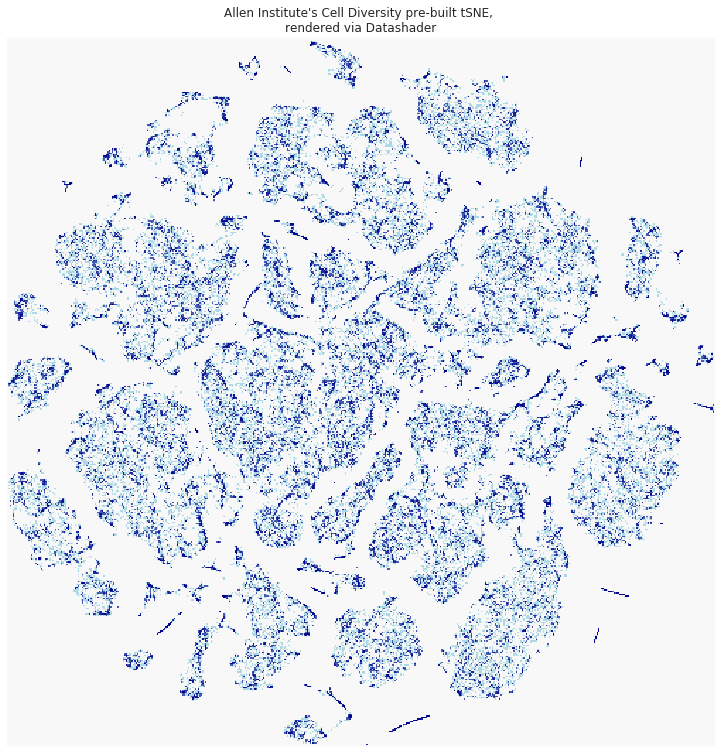

CPU times: user 1.55 s, sys: 42.2 ms, total: 1.59 s
Wall time: 1.59 s


In [10]:
%%time

# Plot via Datashader
from colorcet import fire

#df = pd.DataFrame(embedding, columns=('x', 'y'))
#df['class'] = pd.Series([str(x) for x in target], dtype="category")

cvs = ds.Canvas(plot_width=500, plot_height=500)
agg = cvs.points(source_df, 'tsne_1', 'tsne_2')#, 'blue') #, ds.count_cat('color'))
img = tf.shade(agg, color_key=fire, how='eq_hist')

utils.export_image(img, filename='cell_diversity', background='#f8f8f8')

image = plt.imread('cell_diversity.png')
fig, ax = plt.subplots(figsize=(13, 13))

ligth_gray = '#f8f8f8'
for spine in ax.spines.values():
  spine.set_edgecolor(ligth_gray)

plt.imshow(image)
plt.setp(ax, xticks=[], yticks=[])
plt.title("Allen Institute's Cell Diversity pre-built tSNE, \n"
          "rendered via Datashader",
          fontsize=12)

plt.show()

In [0]:

# JFT-TODO: what I need is to get cluster color categorical?
#source_df['color'] = source_df['tsne_1']
#source_df['color2'] = pd.Series(source_df['tsne_2'][:74985])

#class_labels = pd.DataFrame(sample_annos_df['class_label'][:74985])
#class_labels.describe()


#pd.Series(sample_annos_df['class_label'][:74985])
#merged = pd.concat([source_df,class_labels], axis=1)
#list(merged.columns)
#merged.describe()


In [16]:
#source_df.describe()
colab.data_table.DataTable(source_df)

,sample_name,tsne_1,tsne_2
0,US-1250273_E1_S37,-17.259685,29.346676
1,US-1250273_E2_S01,-17.293492,28.901250
2,US-1250273_E2_S02,-17.265763,28.806693
3,US-1250273_E2_S03,-4.413129,14.393555
4,US-1250273_E2_S04,-22.910442,29.525515
...,...,...,...
74980,SM-GE5P9_S140_E1-50,-11.448132,3.657946
74981,SM-GE5P9_S141_E1-50,-26.091652,-4.152276
74982,SM-GE5P9_S142_E1-50,-25.605991,-3.311589
74983,SM-GE5P9_S143_E1-50,-26.095337,-4.196358


In [12]:
print(len(source_df.index))
#print(len(sample_annos_df.index))
#list(sample_annos_df.columns)

74985
